# Lab for face reconized

In [2]:
import cv2
import os
import random
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import tensorflow as tensor
from tensorflow.keras import layers, models
from tensorflow.keras.layers import Input, Conv2D

print("Load opencv successfully - version: ", cv2.__version__)
print("Load os successfully...")
print("Load random module successfully...")
print("Load numpy array successfully - version: ", np.__version__)
print("Load pytholt successfully - version: ", matplotlib.__version__)


Load opencv successfully - version:  4.11.0
Load os successfully...
Load random module successfully...
Load numpy array successfully - version:  2.0.2
Load pytholt successfully - version:  3.9.4


In [3]:
# Đường dẫn dataset
dataset_path = "WIDER_train/images"
label_file = "wider_face_train_bbx_gt.txt"

In [4]:
def getRandomImageInfo(PATH=""):
    # Đọc file nhãn
    with open(label_file, "r") as f:
        lines = f.readlines()

    faces = []

    # Lấy ngẫu nhiên 1 ảnh
    idx = random.randint(0, len(lines) - 1)
    while not lines[idx].strip().endswith(".jpg"):  # Tìm dòng chứa tên file ảnh
        idx += 1

    file_name = lines[idx].strip()
    num_faces = int(lines[idx + 1].strip())
    faces = lines[idx + 2 : idx + 2 + num_faces]

    return file_name, num_faces, faces, lines, idx

In [38]:
def getImageByFileName(filename):
    # Đọc file nhãn
    with open(label_file, "r") as f:
        lines = f.readlines()

    faces = []

    # Lấy ngẫu nhiên 1 ảnh
    idx = 0
    while not lines[idx].strip().endswith(filename):  # Tìm dòng chứa tên file ảnh
        idx += 1

    file_name = lines[idx].strip()
    num_faces = int(lines[idx + 1].strip())
    faces = lines[idx + 2 : idx + 2 + num_faces]

    return file_name, num_faces, faces, lines, idx

In [6]:
def preProcessingImage(img, IMG_SIZE=(128, 128)):
    # Resize ảnh về kích thước chuẩn
    img_resized = cv2.resize(img, IMG_SIZE)
    img_resized = cv2.cvtColor(img_resized, cv2.COLOR_BGR2GRAY)
    img_resized = img_resized / 255.0  # Chuẩn hóa pixel [0, 1]

    return img_resized

In [7]:
def calculate_confidence(blur, expression, illumination, invalid, occlusion, pose):
    confidence = 1.0

    # Blur
    if blur == 1:
        confidence -= 0.1
    elif blur == 2:
        confidence -= 0.3

    # Expression
    if expression == 1:
        confidence -= 0.1

    # Illumination
    if illumination == 1:
        confidence -= 0.1

    # Invalid box
    if invalid == 1:
        return 0.0

    # Occlusion
    if occlusion == 1:
        confidence -= 0.2
    elif occlusion == 2:
        confidence -= 0.4

    # Pose
    if pose == 1:
        confidence -= 0.2

    # Clamp về khoảng [0, 1]
    return max(0.0, min(1.0, confidence))

In [40]:
file_name, num_faces, faces, lines, idx = getImageByFileName("8--Election_Campain/8_Election_Campain_Election_Campaign_8_71.jpg")
print(file_name)

image = cv2.imread(os.path.join(dataset_path, file_name))
for face in faces:
    face_data = list(map(int, face.split()))
    x, y, w, h, blur, expression, illumination, invalid, occlusion, pose = face_data[:10]

    confidence = calculate_confidence(blur=blur, expression=expression, illumination=illumination, invalid=invalid, occlusion=occlusion, pose=pose)

    print(blur, expression, illumination, invalid, occlusion)
    print("confidence: ", confidence)
    print("x ,y , w, h: ", x,y,w,h)
    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

cv2.imshow("Test confidence: ", image)
cv2.waitKey(0)
cv2.destroyAllWindows()

8--Election_Campain/8_Election_Campain_Election_Campaign_8_71.jpg
0 0 0 0 0
confidence:  1.0
x ,y , w, h:  328 76 118 180
0 0 0 0 0
confidence:  1.0
x ,y , w, h:  624 98 112 156


In [39]:
IMG_SIZE = (128, 128) 

#Lấy 1 ảnh ngẫu nhiên
file_name, num_faces, faces, _, _ = getImageByFileName("8--Election_Campain/8_Election_Campain_Election_Campaign_8_71.jpg")
print(file_name)

# Đọc ảnh
img_path = os.path.join(dataset_path, file_name)
image = cv2.imread(img_path)

ih, iw, _ = image.shape
print(ih, iw)

image = preProcessingImage(image)

scale_x = IMG_SIZE[0] / iw
scale_y = IMG_SIZE[1] / ih


for face in faces: 
    face_data = list(map(int, face.split()))
    x, y, w, h, blur, expression, illumination, invalid, occlusion, pose = face_data[:10]
    
    confidence = calculate_confidence(blur=blur, expression=expression, illumination=illumination, invalid=invalid, occlusion=occlusion, pose=pose)
    
    x = int(x * scale_x)
    y = int(y * scale_y)
    w = int(w * scale_x)
    h = int(h * scale_y)
    print(x, y, w, h, confidence)
    
    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

cv2.imshow("hinh", image)
cv2.waitKey(0)
cv2.destroyAllWindows()
print(image.shape)
print("This is image being RGB")
print("Because the value in 1 layout is increment")

8--Election_Campain/8_Election_Campain_Election_Campaign_8_71.jpg
687 1024
41 14 14 33 1.0
78 18 14 29 1.0
(128, 128)
This is image being RGB
Because the value in 1 layout is increment


In [35]:

def load_dataset(annotation_file, image_root, IMG_SIZE = (128, 128)):
    print("load image is processing...")
    x_dataset = []
    y_dataset = []

    with open(annotation_file, "r") as file:
        lines = file.readlines()

    i = 0
    while i < len(lines):
        img_path = os.path.join(image_root, lines[i].strip())  # Đọc đường dẫn ảnh
        num_faces = int(lines[i + 1].strip())  # Số lượng khuôn mặt
        faces = lines[i + 2 : i + 2 + num_faces]  # Danh sách bounding boxes
        print("load image: ", img_path)

        if num_faces == 0:
            num_faces = 1

        # Đọc ảnh
        img = cv2.imread(img_path)
        if img is None:
            i += 2 + num_faces
            continue  # Bỏ qua nếu ảnh không tồn tại

        h_img, w_img, _ = img.shape
        print(f"Ảnh {img_path} có kích thước: {w_img}x{h_img}")

        # Resize ảnh về kích thước chuẩn
        img_resized = preProcessingImage(img, IMG_SIZE=IMG_SIZE)

        for face in faces:
            face_data = list(map(int, face.split()))
            x, y, w, h, blur, expression, illumination, invalid, occlusion, pose = face_data[:10]

            # CHUẨN HÓA tọa độ theo kích thước ảnh gốc
            x_norm = x / w_img
            y_norm = y / h_img
            w_norm = w / w_img
            h_norm = h / h_img

            confidence = calculate_confidence(blur=blur, expression=expression, illumination=illumination, invalid=invalid, occlusion=occlusion, pose=pose)

            if confidence < 0.5:
                continue

            # Nhị phân hóa độ tin cậy
            confidence = 1.0 if confidence >= 0.8 else 0.0
            
            x_dataset.append(img_resized)
            y_dataset.append([x_norm, y_norm, w_norm, h_norm, confidence])
            
        i += 2 + num_faces

    x_dataset = np.array(x_dataset, dtype="float32")
    y_dataset = np.array(y_dataset)

    print("Dữ liệu đã load xong!")
    return x_dataset, y_dataset


In [ ]:
# Xây dựng kiến trúc CNN
def build_model():
    model = models.Sequential([
        Input(shape=(128, 128, 1)), 
        Conv2D(32, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(128, activation="relu"),
        layers.Dense(5, activation="sigmoid")  # 5 giá trị: (x, y, w, h, conf)
    ])
    return model



In [36]:

x_train, y_train = load_dataset("wider_face_train_bbx_gt.txt", "WIDER_train/images")
x_val, y_val = load_dataset("wider_face_val_bbx_gt.txt", "WIDER_train/images")


print(f"Kích thước của X_train: {x_train.shape}")
print(f"Kích thước của Y_val: {y_train.shape}")
print(f"Kiểu dữ liệu của X_train: {x_train.dtype}")

np.save("x_train.npy", x_train)
np.save("y_train.npy", y_train)
np.save("x_val.npy", x_train)
np.save("y_val.npy", y_train)

load image is processing...
load image:  WIDER_train/images\0--Parade/0_Parade_marchingband_1_849.jpg
Ảnh WIDER_train/images\0--Parade/0_Parade_marchingband_1_849.jpg có kích thước: 1024x1385
load image:  WIDER_train/images\0--Parade/0_Parade_Parade_0_904.jpg
Ảnh WIDER_train/images\0--Parade/0_Parade_Parade_0_904.jpg có kích thước: 1024x1432
load image:  WIDER_train/images\0--Parade/0_Parade_marchingband_1_799.jpg
Ảnh WIDER_train/images\0--Parade/0_Parade_marchingband_1_799.jpg có kích thước: 1024x768
load image:  WIDER_train/images\0--Parade/0_Parade_marchingband_1_117.jpg
Ảnh WIDER_train/images\0--Parade/0_Parade_marchingband_1_117.jpg có kích thước: 1024x682
load image:  WIDER_train/images\0--Parade/0_Parade_marchingband_1_778.jpg
Ảnh WIDER_train/images\0--Parade/0_Parade_marchingband_1_778.jpg có kích thước: 1024x852
load image:  WIDER_train/images\0--Parade/0_Parade_Parade_0_343.jpg
Ảnh WIDER_train/images\0--Parade/0_Parade_Parade_0_343.jpg có kích thước: 1024x931
load image:  WID

In [ ]:
from sklearn.model_selection import train_test_split

x_train = np.load("x_train.npy")
y_train = np.load("y_train.npy")
x_test_val = np.load("x_val.npy")
y_test_val = np.load("y_val.npy")

x_val, x_test, y_val, y_test = train_test_split(x_test_val, y_test_val, test_size=0.5, random_state=42)

print("Load dataset successfully")

print("Số lượng tập train: ", len(x_train))
print("Số lượng tập test: ", len(x_test))
print("Số lượng tập validation: ", len(x_val))

print("Shape x_train: ", x_train.shape)
print("Shape y_train: ", y_train.shape)

print("Ví dụ x, y, w, h", y_train[10])

num_of_data = len(x_train) + len(x_test) + len(x_val)

print("Tỉ lệ train - test - val: ", round(len(x_train)/num_of_data, 2), round(len(x_test)/num_of_data,2),round(len(x_val)/num_of_data,2))

Load dataset successfully
Số lượng tập test:  52449
Số lượng tập validation:  52448


In [39]:
# Huấn luyện
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

model = build_model()
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

checkpoint = ModelCheckpoint("face_detection_model_2_5.keras", save_best_only=True)

earlystop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

model.fit(  x_train, 
            y_train, 
            epochs=15, 
            batch_size=16, 
            validation_data=(x_val, y_val),
            callbacks=[checkpoint, earlystop])

# Sau khi huấn luyện, đánh giá trên test set
test_loss, test_mae = model.evaluate(x_test, y_test)
print(f"Test Loss: {test_loss:.4f} | Test MAE: {test_mae:.4f}")

model.save('face_detection_model_2_5.keras')

Epoch 1/15
6557/6557 ━━━━━━━━━━━━━━━━━━━━ 774s 118ms/step - loss: 0.0627 - mae: 0.1676 - val_loss: 0.0483 - val_mae: 0.1368
Epoch 2/15
6557/6557 ━━━━━━━━━━━━━━━━━━━━ 823s 126ms/step - loss: 0.0492 - mae: 0.1368 - val_loss: 0.0451 - val_mae: 0.1292
Epoch 3/15
6557/6557 ━━━━━━━━━━━━━━━━━━━━ 811s 124ms/step - loss: 0.0465 - mae: 0.1302 - val_loss: 0.0449 - val_mae: 0.1296
Epoch 4/15
6557/6557 ━━━━━━━━━━━━━━━━━━━━ 842s 128ms/step - loss: 0.0454 - mae: 0.1275 - val_loss: 0.0431 - val_mae: 0.1249
Epoch 5/15
6557/6557 ━━━━━━━━━━━━━━━━━━━━ 845s 129ms/step - loss: 0.0445 - mae: 0.1253 - val_loss: 0.0428 - val_mae: 0.1235
Epoch 6/15
6557/6557 ━━━━━━━━━━━━━━━━━━━━ 778s 119ms/step - loss: 0.0438 - mae: 0.1236 - val_loss: 0.0420 - val_mae: 0.1219
Epoch 7/15
6557/6557 ━━━━━━━━━━━━━━━━━━━━ 775s 118ms/step - loss: 0.0437 - mae: 0.1233 - val_loss: 0.0419 - val_mae: 0.1198
Epoch 8/15
6557/6557 ━━━━━━━━━━━━━━━━━━━━ 773s 118ms/step - loss: 0.0430 - mae: 0.1216 - val_loss: 0.0418 - val_mae: 0.1206
Epoch 9/

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def compute_iou(boxA, boxB, image_size=128):
    # Chuyển từ tọa độ chuẩn hóa sang pixel
    boxA = boxA * image_size
    boxB = boxB * image_size

    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[0] + boxA[2], boxB[0] + boxB[2])
    yB = min(boxA[1] + boxA[3], boxB[1] + boxB[3])
    interArea = max(0, xB - xA) * max(0, yB - yA)
    boxAArea = boxA[2] * boxA[3]
    boxBArea = boxB[2] * boxB[3]
    return interArea / (boxAArea + boxBArea - interArea + 1e-6)

def evaluate_f1(pred_boxes, gt_boxes, iou_threshold=0.5):
    tp, fp, fn = 0, 0, 0
    for pred, gt in zip(pred_boxes, gt_boxes):
        pred_box = pred[:4]
        gt_box = gt[:4]

        iou = compute_iou(pred_box, gt_box)
        if iou >= iou_threshold:
            tp += 1
        else:
            fp += 1
            fn += 1
    precision = tp / (tp + fp + 1e-6)
    recall = tp / (tp + fn + 1e-6)
    f1 = 2 * precision * recall / (precision + recall + 1e-6)
    return precision, recall, f1

def plot_metrics(metrics_list, iou_thresholds):
    precisions, recalls, f1s = zip(*metrics_list)
    plt.figure(figsize=(10, 6))
    plt.plot(iou_thresholds, precisions, label='Precision')
    plt.plot(iou_thresholds, recalls, label='Recall')
    plt.plot(iou_thresholds, f1s, label='F1 Score')
    plt.xlabel("IoU Threshold")
    plt.ylabel("Score")
    plt.title("Precision / Recall / F1 Score vs IoU Threshold")
    plt.legend()
    plt.grid(True)
    plt.show()



1640/1640 ━━━━━━━━━━━━━━━━━━━━ 112s 68ms/step
[0.51748276 0.40515798 0.02597228 0.04823588]
[0.85253906 0.46412884 0.01953125 0.03367496]
[0.54456884 0.4677581  0.03058849 0.03281264]
[0.56933594 0.48462665 0.04980469 0.0431918 ]
[0.6782006  0.24095483 0.01127311 0.02662837]
[0.31738281 0.30948905 0.02929688 0.05109489]
[0.48954654 0.56392676 0.00382903 0.00706267]
[0.38183594 0.57101025 0.0078125  0.01317716]
[0.5067153  0.27199617 0.01534756 0.05589046]
[0.28710938 0.34482759 0.04199219 0.05890805]
[0.5586426  0.6620801  0.02478581 0.04792524]
[0.19335938 0.81384615 0.03417969 0.07692308]
[0.38144097 0.15936333 0.25270027 0.47859278]
[0.72460938 0.25       0.19726562 0.59375   ]
[0.49845037 0.5377182  0.01958394 0.03636146]
[0.875      0.67248908 0.02148438 0.0349345 ]
[0.49293256 0.30296534 0.01343381 0.02660096]
[0.24804688 0.16140777 0.01660156 0.02548544]
[0.4195423  0.42782152 0.01112751 0.02006185]
[0.30566406 0.15521978 0.01171875 0.02335165]
[0.50253046 0.2759799  0.10236046 

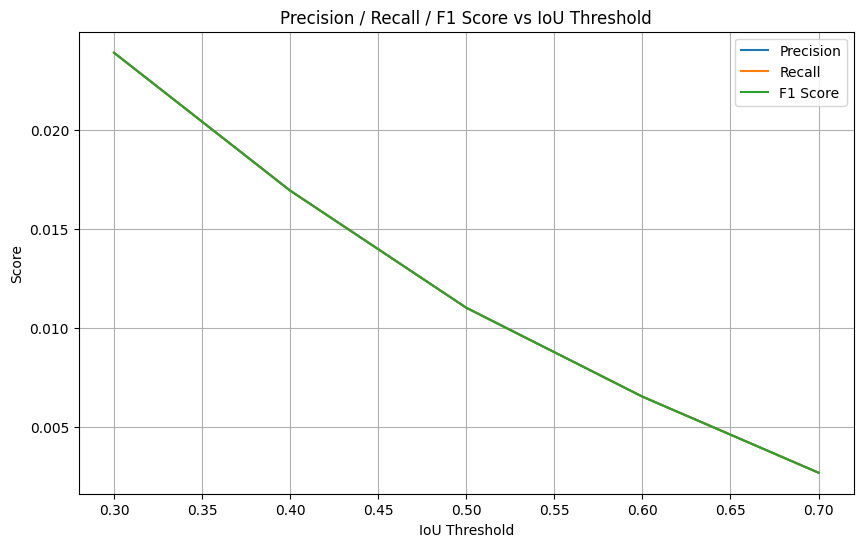

In [72]:
from tensorflow.keras.models import load_model

# Load dữ liệu test và mô hình
model = load_model("face_detection_model_2_5.keras")

# Dự đoán toàn bộ x_test
y_pred = model.predict(x_test)

# Đánh giá theo nhiều IoU threshold
iou_thresholds = [0.7, 0.6, 0.5, 0.4, 0.3]
metrics_list = []

for thresh in iou_thresholds:
    precision, recall, f1 = evaluate_f1(y_pred, y_test, iou_threshold=thresh)
    print(precision, recall, f1)
    metrics_list.append([precision, recall, f1])

# Vẽ biểu đồ
plot_metrics(metrics_list, iou_thresholds)


In [9]:
def sliding_window(image, window_size=(128, 128), stride=32):
    """
    Hàm thực hiện sliding window trên ảnh đầu vào.
    
    :param image: Ảnh đầu vào (numpy array)
    :param window_size: Kích thước cửa sổ (chiều cao, chiều rộng)
    :param stride: Bước nhảy của cửa sổ
    :return: Trả về danh sách (x, y, window) với x,y là tọa độ gốc của cửa sổ, window là phần ảnh được cắt
    """
    windows = []
    h, w = image.shape[:2]
    win_h, win_w = window_size

    for y in range(0, h - win_h + 1, stride):
        for x in range(0, w - win_w + 1, stride):
            window = image[y:y + win_h, x:x + win_w]
            windows.append((x, y, window))
    
    return windows

In [10]:
def non_max_suppression(boxes, confidences, iou_threshold=0.4, max_output=3):
    if len(boxes) == 0:
        return []

    boxes = np.array(boxes)
    confidences = np.array(confidences)

    x1 = boxes[:, 0]
    y1 = boxes[:, 1]
    x2 = boxes[:, 0] + boxes[:, 2]
    y2 = boxes[:, 1] + boxes[:, 3]

    indices = np.argsort(confidences)[::-1]
    keep = []

    while len(indices) > 0:
        i = indices[0]
        keep.append(i)

        xx1 = np.maximum(x1[i], x1[indices[1:]])
        yy1 = np.maximum(y1[i], y1[indices[1:]])
        xx2 = np.minimum(x2[i], x2[indices[1:]])
        yy2 = np.minimum(y2[i], y2[indices[1:]])

        w = np.maximum(0, xx2 - xx1)
        h = np.maximum(0, yy2 - yy1)

        inter = w * h
        union = (x2[i] - x1[i]) * (y2[i] - y1[i]) + \
                (x2[indices[1:]] - x1[indices[1:]]) * (y2[indices[1:]] - y1[indices[1:]]) - inter

        iou = inter / (union + 1e-6)

        indices = indices[1:][iou < iou_threshold]

    return keep[:max_output]

In [42]:
def detect_face(image_path, model, img_size=(128, 128), CONF = 0.9):
    # Đọc ảnh
    image = cv2.imread(image_path)
    h_img, w_img, _ = image.shape  # Lấy kích thước ảnh gốc

    boxes = []
    confidences = []
    
    window_size = int(max(h_img, w_img)/3)
    windows = sliding_window(image, window_size=(window_size, window_size), stride=int(window_size/2))
    for window in windows:
        x_window, y_window, input_img = window
        
        size, _, _ = input_img.shape

        # Chuyển ảnh sang grayscale
        # Resize ảnh về kích thước phù hợp với mô hình
        # Chuẩn hóa ảnh
        pre_processing_image = preProcessingImage(input_img)

        # Chuyển thành tensor có shape phù hợp (1, 128, 128, 1)
        input_img = np.expand_dims(pre_processing_image, axis=-1)  # Thêm channel
        input_img = np.expand_dims(input_img, axis=0)  # Thêm batch size

        # Dự đoán tọa độ (x, y, w, h)
        prediction = model.predict(input_img)[0]  # Lấy kết quả đầu ra

        # Giải chuẩn hóa về kích thước gốc
        x, y, w, h, conf = prediction

        if conf < CONF: 
            continue
        
        x = int(x * size + x_window)
        y = int(y * size + y_window)
        w = int(w * size)
        h = int(h * size)
        
        boxes.append([x, y, w, h])
        confidences.append(conf)
        
        print("Confidence face: ",conf)

    keep_indices = non_max_suppression(boxes, confidences, iou_threshold=0.4, max_output=3)

    for idx in keep_indices:
        x, y, w, h = boxes[idx]
        conf = confidences[idx]
        cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.putText(image, f"{conf:.2f}", (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,255,0), 1)

    # Hiển thị ảnh kết quả
    cv2.imshow("Detected Face", image)
    cv2.waitKey(0)
    cv2.destroyAllWindows()


In [45]:
from tensorflow.keras.models import load_model

# Load mô hình đã lưu
model_face_detection = load_model("face_detection_model_2_5.keras")

image = cv2.imread("khuon-mat-tron-co-dep-khong-1.jpg")
h_img, w_img, _ = image.shape  # Lấy kích thước ảnh gốc

pre_processing_image = preProcessingImage(image)

# Chuyển thành tensor có shape phù hợp (1, 128, 128, 1)
input = np.expand_dims(pre_processing_image, axis=-1)  # Thêm channel
input = np.expand_dims(input, axis=0)  # Thêm batch size

# Dự đoán tọa độ (x, y, w, h)
prediction = model_face_detection.predict(input)[0]  # Lấy kết quả đầu ra

# Giải chuẩn hóa về kích thước gốc
x, y, w, h, conf = prediction

x = int(x * w_img)
y = int(y * h_img)
w = int(w * w_img)
h = int(h * h_img)

if conf > 0.9:
    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

print("Kích thước: ", w_img, h_img)
print("Vị trí gương mặt", x, y, w, h)
print("Độ tin cậy", conf)

# Hiển thị ảnh kết quả
cv2.imshow("Detected Face", image)
cv2.waitKey(0)
cv2.destroyAllWindows()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
Kích thước:  900 900
Vị trí gương mặt 216 101 474 477
Độ tin cậy 0.99658954


In [ ]:
from tensorflow.keras.models import load_model

# Load mô hình đã lưu
model_face_detection = load_model("face_detection_model_2_5.keras")

# Test với một ảnh
detect_face("kylian-mbappe-thach-thuc-cristiano-ronaldo-va-cac-huyen-thoai-66286.jpg", model_face_detection)


NameError: name 'sliding_window' is not defined